In [5]:
import pandas as pd


In [ ]:
train_dataframe = pd.read_csv("train.csv", delimiter=',', encoding="utf-8-sig", engine='python').set_index('Id')
patch_id_wsi_dataframe = pd.read_csv("patch_id_wsi.csv", delimiter=',', encoding="utf-8-sig", engine='python').set_index('Id')

train_df = train_dataframe.to_dict('index')
wsi_df = patch_id_wsi_dataframe.to_dict('index')

In [3]:
print("Train contains: {}, WSI contains: {}".format(len(train_df), len(wsi_df)))

Train contains: 220025, WSI contains: 192752


In [4]:
for wsi_key in wsi_df.keys():
    if train_df[wsi_key] == None: train_df[wsi_key] = dict()
    train_df[wsi_key]['wsi'] = wsi_df[wsi_key]['wsi']
len(train_df)

220025

In [5]:
new_df = pd.DataFrame.from_dict(train_df)
new_df = new_df.T
new_df.to_csv("train_with_wsi.csv", index=True)

In [36]:
wsi_names = pd.read_csv("patch_id_wsi.csv", delimiter=',', encoding="utf-8-sig", engine='python').set_index('wsi')
wsi_names_df = wsi_names.to_dict('index')
wsi_names_set = set(wsi_names.index.values)

wsi_names = pd.read_csv("patch_id_wsi.csv", delimiter=',', encoding="utf-8-sig", engine='python').set_index('Id')
wsi_names_df = wsi_names.to_dict('index')

train_dataframe.head()
# wsi_names_df

wsi_dict = dict()
for img_id in wsi_names.index.values: #train_dataframe != wsi_names
    for wsi_name in wsi_names_set:
        if not wsi_name in wsi_dict.keys(): wsi_dict[wsi_name] = []
#         img_id = img_id.replace("data/HisCancer_dataset/preprocessed/", "").replace(".npy", "")
        if wsi_names_df[img_id]['wsi'] == wsi_name:
            wsi_dict[wsi_name].append(img_id.replace("data/HisCancer_dataset/preprocessed/", "").replace(".npy", ""))

In [42]:
for key in wsi_dict.keys():
    with open(key+".csv", 'a') as prob_file:
        prob_file.write('id,label\n')
        for ids in wsi_dict[key]:
            prob_file.write('{},{}\n'.format(ids, train_df["data/HisCancer_dataset/preprocessed/"+ids+".npy"]['label']))

# Find Similar Images

In [6]:
pred = pd.read_csv("000c46d3-CP4_F1_PT2019-02-26-06-23-29-725832-two_VT000c46d3_LR0.01_BS64_IMG224.pth-two-F0-T0.5-Prob-Prep(240)TTAPowerNasnet0.9714.csv", delimiter=',', encoding="utf-8-sig", engine='python').set_index('Id')
pred.head()

,Label
Id,
74aaec57e5e54e62092ec7a80facab2602769d21,0.999890
8020ba42f78d2ebef0bbcc3dc2fd14bf03b6a724,0.999828
6cb50dc0c9c37c0b9db4d93c1efd8be92e2b20e5,0.999825
dfd4bb9aa97715fc0162832faeec7d8c3e32ee31,0.999817
8085d3d81d410e972c3d0943c7da01593d87a434,0.999809


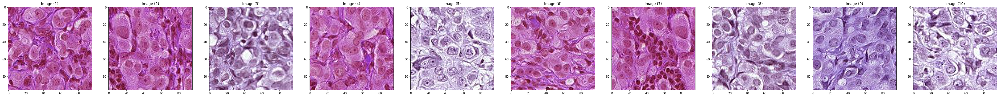

In [7]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

def show_images(images, cols = 1, titles = None):
    """Display a list of images in a single figure with matplotlib.
    
    Parameters
    ---------
    images: List of np.arrays compatible with plt.imshow.
    
    cols (Default = 1): Number of columns in figure (number of rows is 
                        set to np.ceil(n_images/float(cols))).
    
    titles: List of titles corresponding to each image. Must have
            the same length as titles.
    """
    assert((titles is None)or (len(images) == len(titles)))
    n_images = len(images)
    if titles is None: titles = ['Image (%d)' % i for i in range(1,n_images + 1)]
    fig = plt.figure()
    for n, (image, title) in enumerate(zip(images, titles)):
        a = fig.add_subplot(cols, np.ceil(n_images/float(cols)), n + 1)
        if image.ndim == 2:
            plt.gray()
        plt.imshow(image)
        a.set_title(title)
    fig.set_size_inches(np.array(fig.get_size_inches()) * n_images)
    plt.show()
images = [cv2.imread("HisCancer/test/{}.tif".format(x)) for x in pred.index.values[0:10]]
show_images(images)

In [9]:
images = [cv2.imread("HisCancer/test/{}.tif".format(x)) for x in pred.index.values[10:60]]; show_images(images, 5)

In [12]:
i = int(len(pred)/4)
images = [cv2.imread("HisCancer/test/{}.tif".format(x)) for x in pred.index.values[i:i+50]]; show_images(images, 5)

In [13]:
i = int(len(pred)/2)
images = [cv2.imread("HisCancer/test/{}.tif".format(x)) for x in pred.index.values[i:i+50]]; show_images(images, 5)

In [15]:
images = [cv2.imread("HisCancer/test/{}.tif".format(x)) for x in pred.index.values[-50:-1]]; show_images(images, 5)

In [9]:
wsi_eg = pd.read_csv("train_with_wsi.csv", delimiter=',', encoding="utf-8-sig", engine='python').set_index('id')

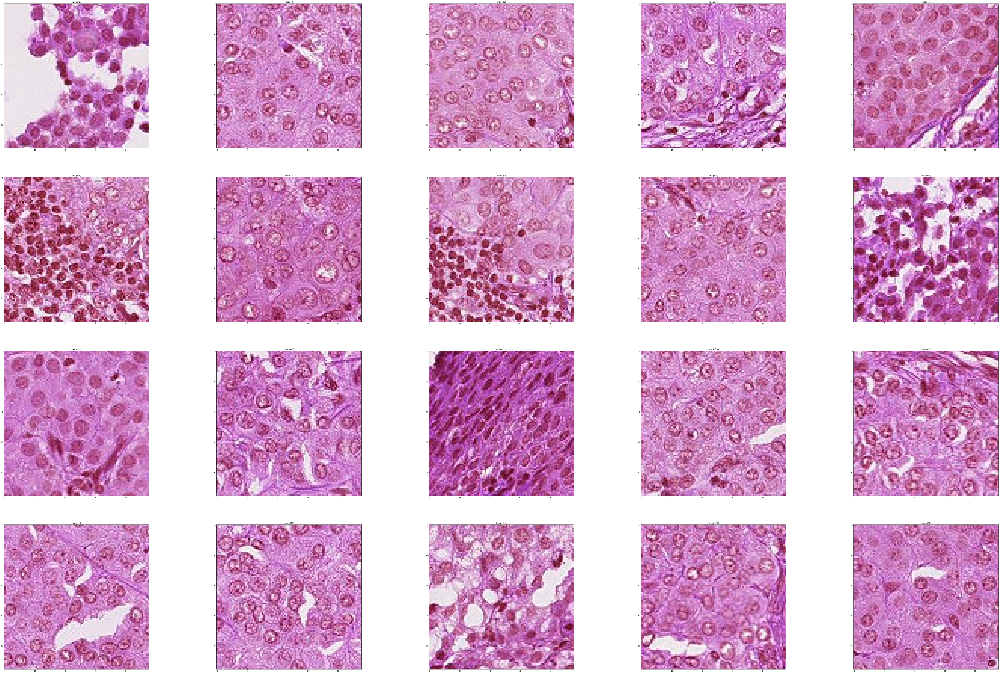

In [17]:
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[0:20]]; show_images(images, 4)

camelyon16_train_tumor_108 to camelyon16_train_tumor_108


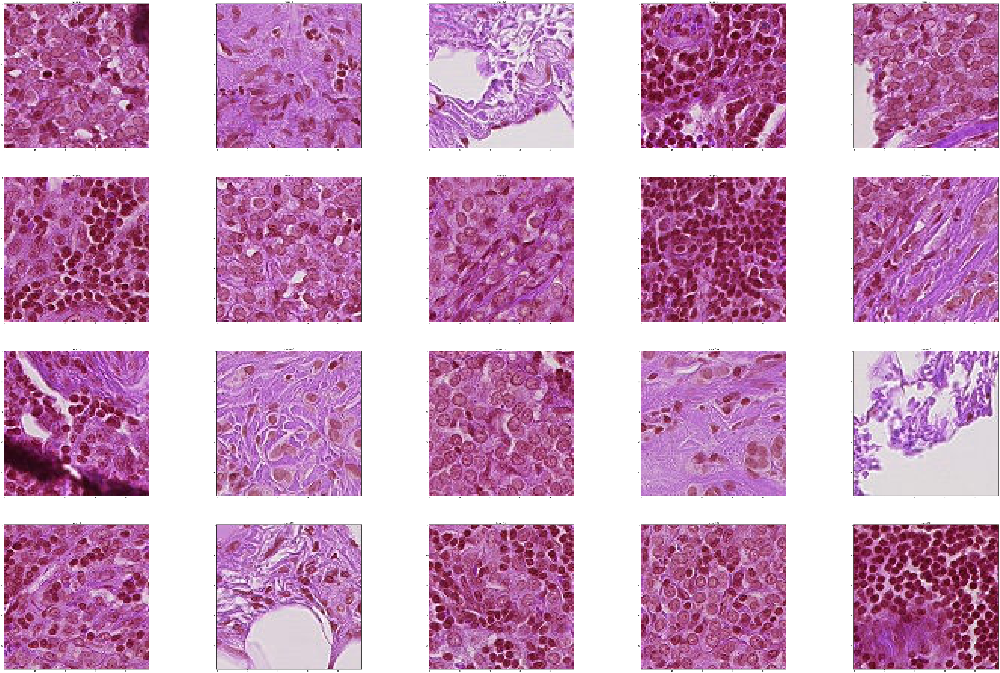

In [22]:
i=1000
print("{} to {}".format(wsi_eg.loc[wsi_eg.index.values[i]]['wsi'], wsi_eg.loc[wsi_eg.index.values[i+20]]['wsi']))
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[i:i+20]]; show_images(images, 4)

camelyon16_train_tumor_095 to camelyon16_train_tumor_095


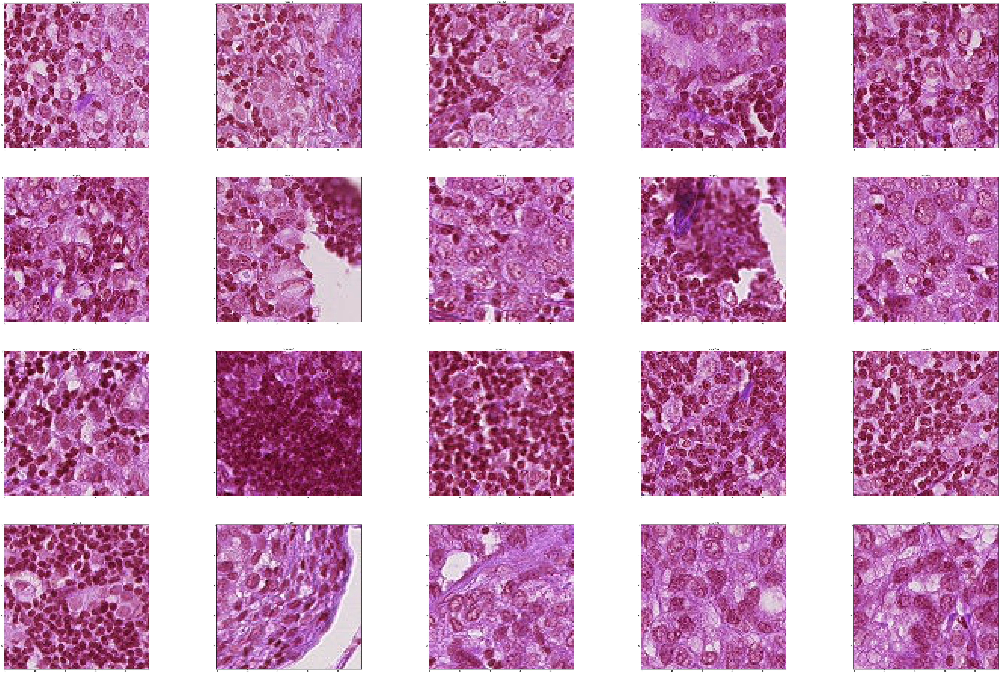

In [24]:
i=20000
print("{} to {}".format(wsi_eg.loc[wsi_eg.index.values[i]]['wsi'], wsi_eg.loc[wsi_eg.index.values[i+20]]['wsi']))
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[i:i+20]]; show_images(images, 4)

camelyon16_train_tumor_090 to camelyon16_train_tumor_090


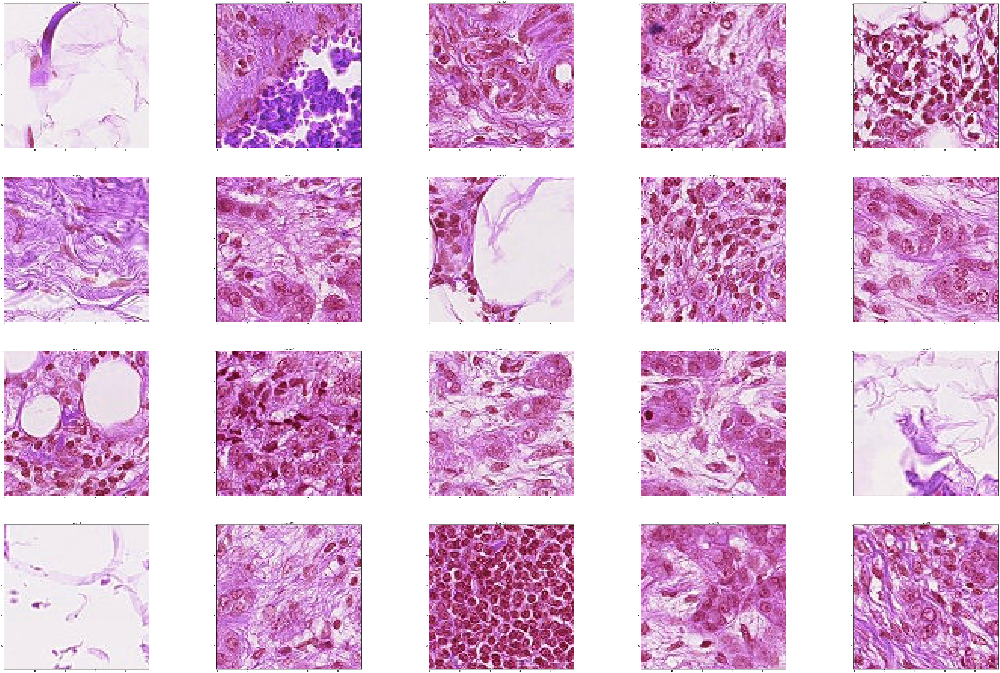

In [25]:
i=30000
print("{} to {}".format(wsi_eg.loc[wsi_eg.index.values[i]]['wsi'], wsi_eg.loc[wsi_eg.index.values[i+20]]['wsi']))
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[i:i+20]]; show_images(images, 4)

camelyon16_train_tumor_068 to camelyon16_train_tumor_068


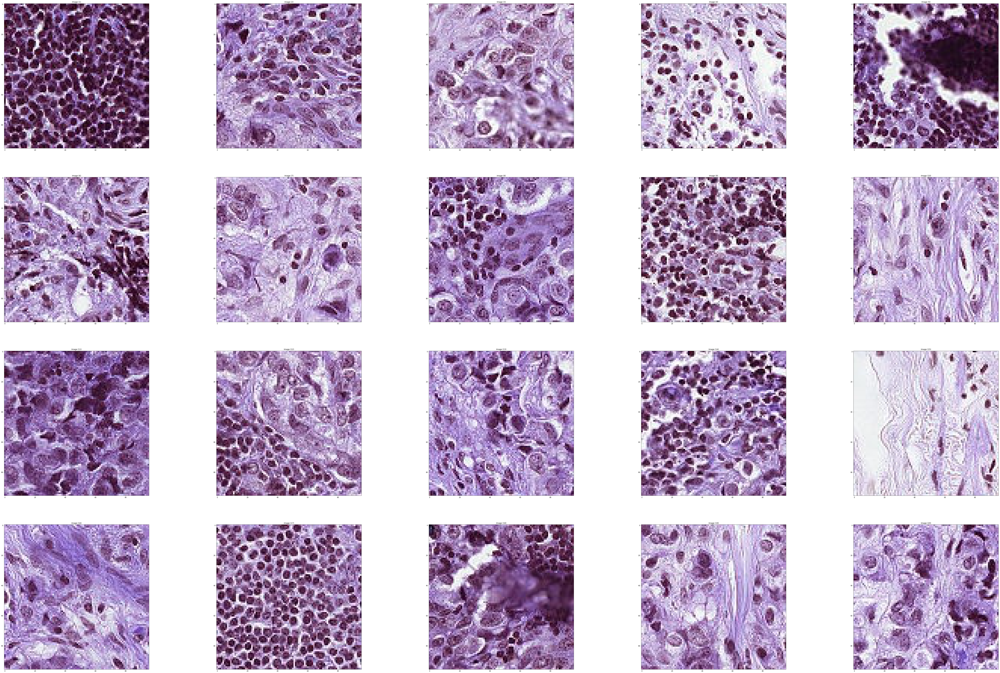

In [26]:
i=50000
print("{} to {}".format(wsi_eg.loc[wsi_eg.index.values[i]]['wsi'], wsi_eg.loc[wsi_eg.index.values[i+20]]['wsi']))
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[i:i+20]]; show_images(images, 4)

camelyon16_train_tumor_021 to camelyon16_train_tumor_021


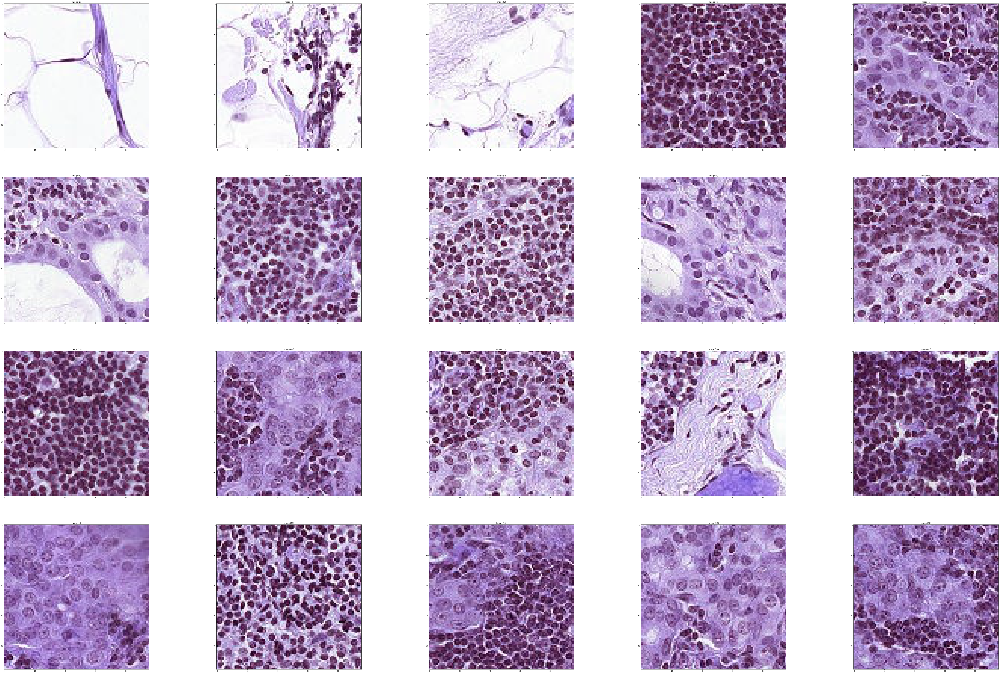

In [27]:
i=100000
print("{} to {}".format(wsi_eg.loc[wsi_eg.index.values[i]]['wsi'], wsi_eg.loc[wsi_eg.index.values[i+20]]['wsi']))
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[i:i+20]]; show_images(images, 4)

camelyon16_train_tumor_007 to camelyon16_train_tumor_006


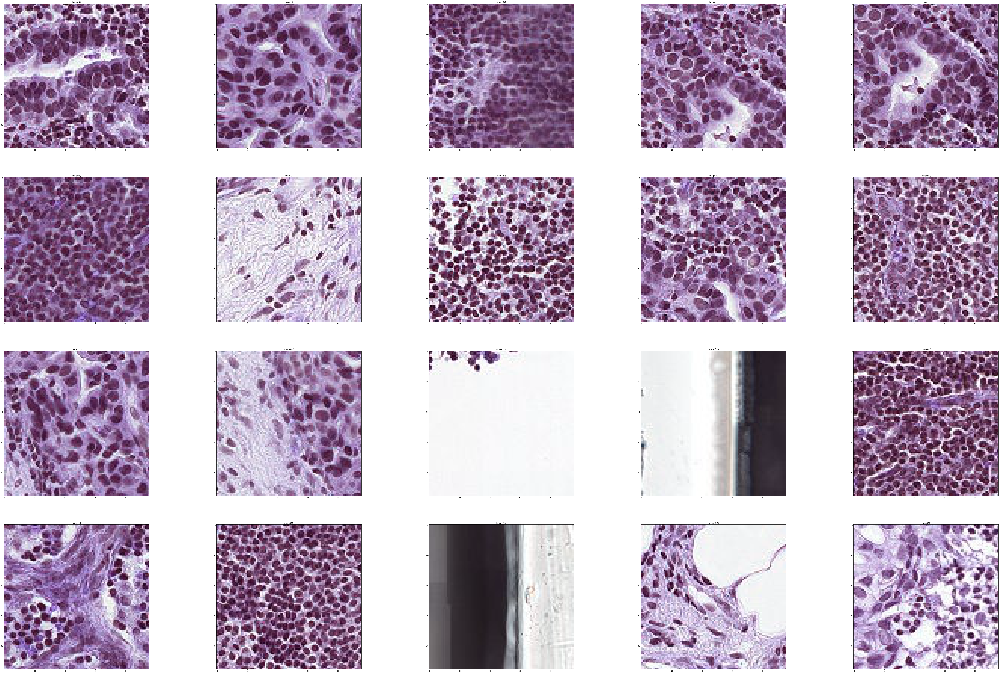

In [29]:
i=110000
print("{} to {}".format(wsi_eg.loc[wsi_eg.index.values[i]]['wsi'], wsi_eg.loc[wsi_eg.index.values[i+20]]['wsi']))
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[i:i+20]]; show_images(images, 4)

label                             1
wsi      camelyon16_train_tumor_007
Name: c448ff7117b8382151d115fb54a63987e0fb5c0d, dtype: object to label                             1
wsi      camelyon16_train_tumor_007
Name: 7a0c08fce92d57350add2b13e4c6e825122e7b1a, dtype: object


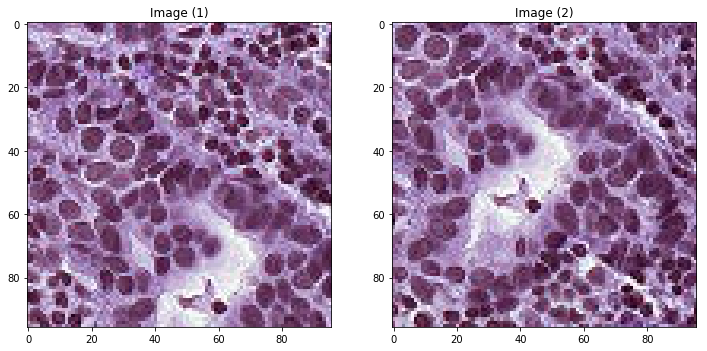

In [11]:
i=110003
print("{} to {}".format(wsi_eg.loc[wsi_eg.index.values[i]], wsi_eg.loc[wsi_eg.index.values[i+1]]))
images = [cv2.imread("HisCancer/train/{}.tif".format(x)) for x in wsi_eg.index.values[i:i+2]]; show_images(images, 1)